In [1]:
import sys
print(sys.executable)
import os
os.sys.path
import sys
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import cv2
from skimage.filters import threshold_otsu
from skimage.filters import gabor
import matplotlib.pyplot as plt

print("Python executable:", sys.executable)
print("NumPy version:", np.__version__)
print("Pandas version:", pd.__version__)
print("Matplotlib version:", mpl.__version__)



H:\Thesis\Code\myenv\Scripts\python.exe
Python executable: H:\Thesis\Code\myenv\Scripts\python.exe
NumPy version: 1.26.4
Pandas version: 2.2.2
Matplotlib version: 3.9.0


In [2]:
import sys
print(sys.executable)


H:\Thesis\Code\myenv\Scripts\python.exe


In [3]:
import cv2
import numpy as np
import os
from skimage.filters import threshold_otsu
from skimage.filters import gabor
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu
import matplotlib.pyplot as plt


In [12]:
os.chdir(r'H:\Thesis')


count how many object each set ( train, valid, test) has 

In [5]:

def count_total_bounding_boxes(labels_folder):
    total_bounding_boxes = 0
    label_files = [f for f in os.listdir(labels_folder) if f.endswith('.txt')]

    for label_file in label_files:
        label_file_path = os.path.join(labels_folder, label_file)
        with open(label_file_path, 'r') as file:
            lines = file.readlines()
            total_bounding_boxes += len(lines)  # Assuming each line in a label file represents a bounding box

    return total_bounding_boxes  # Corrected variable name here


# Paths to your labels folders
labels_folders = [
    r'./roboflowV6_1169\train\labels',
    r'./roboflowV6_1169\valid\labels',
    r'./roboflowV6_1169\test\labels'
]

total_bboxes = 0
for folder in labels_folders:
    bboxes = count_total_bounding_boxes(folder)
    total_bboxes += bboxes
    print(f"Total bounding boxes in {folder}: {bboxes}")

print(f"Grand total of bounding boxes across all folders: {total_bboxes}")



Total bounding boxes in ./roboflowV6_1169\train\labels: 2613
Total bounding boxes in ./roboflowV6_1169\valid\labels: 244
Total bounding boxes in ./roboflowV6_1169\test\labels: 124
Grand total of bounding boxes across all folders: 2981


crop bounding boxes from images

In [21]:

# Function to read bounding box coordinates from label file
def read_label_file(label_file_path):
    with open(label_file_path, 'r') as file:
        lines = file.readlines()
        # Extract bounding box coordinates
        bbox_coords = []
        for line in lines:
            values = line.strip().split()
            # Extract the last four values (x, y, width, height)
            bbox_coords.append(list(map(float, values[1:5])))
    return bbox_coords

# Function to convert normalized bounding box coordinates to pixel values


def convert_yolov9_to_pixel(bbox_yolov9, image_width, image_height):
    centerX, centerY, width, height = bbox_yolov9
    
    # Calculate bounding box coordinates in pixel values
    x_center_pixel = int(centerX * image_width)
    y_center_pixel = int(centerY * image_height)
    width_pixel = int(width * image_width)
    height_pixel = int(height * image_height)
    
    # Calculate x_min, y_min, x_max, y_max
    x_min = x_center_pixel - (width_pixel // 2)
    y_min = y_center_pixel - (height_pixel // 2)
    x_max = x_min + width_pixel
    y_max = y_min + height_pixel
    
    # Return bounding box coordinates as tuple
    bbox_pixel = (x_min, y_min, x_max, y_max)
    
    return bbox_pixel
# Function to crop bounding boxes from images
def crop_bounding_boxes(images_folder, labels_folder, output_folder):
    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # List all image files
    image_files = os.listdir(images_folder)

    for image_file in image_files:
        if image_file.endswith('.jpg'):  # Assuming images are JPEG format
            # Get image path
            image_path = os.path.join(images_folder, image_file)
            # Read image
            image = cv2.imread(image_path)

            # Get corresponding label file path
            label_file_name = image_file.replace('.jpg', '.txt')
            label_file_path = os.path.join(labels_folder, label_file_name)

            # Read bounding box coordinates from label file
            bbox_coords = read_label_file(label_file_path)

            # Crop bounding boxes from image and save
            for i, bbox_normalized in enumerate(bbox_coords):
                # Convert normalized coordinates to pixel values
                bbox_pixel = convert_yolov9_to_pixel(bbox_normalized, image.shape[1], image.shape[0])
                x_min, y_min, x_max, y_max = bbox_pixel

                # Crop ROI from image
                cropped_image = image[y_min:y_max, x_min:x_max]

                # Save cropped image with unique name for each bounding box
                output_file_name = f'{os.path.splitext(image_file)[0]}_bbox_{i}.jpg'
                output_file_path = os.path.join(output_folder, output_file_name)
                cv2.imwrite(output_file_path, cropped_image)

                print(f'Cropped bounding box {i} from {image_file} saved as {output_file_name}')

# Define the paths for each dataset
datasets = {
    "train": {
        "images_folder": r'./roboflowV6_1169\original\train\images',
        "labels_folder": r'./roboflowV6_1169\original\train\labels',
        "cropped_folder": r'./roboflowV6_1169/original/bounded_new'
    },
    "valid": {
        "images_folder": r'./roboflowV6_1169\original\valid\images',
        "labels_folder": r'./roboflowV6_1169\original\valid\labels',
        "cropped_folder": r'./roboflowV6_1169/original/bounded_new'
    },
    "test": {
        "images_folder": r'./roboflowV6_1169\original\test\images',
        "labels_folder": r'./roboflowV6_1169\original\test\labels',
        "cropped_folder": r'./roboflowV6_1169/original/bounded_new'
    }
}

# Process each dataset
for key, paths in datasets.items():
    crop_bounding_boxes(paths["images_folder"], paths["labels_folder"], paths["cropped_folder"])


Cropped bounding box 0 from 1D3A3150_JPG.rf.a393745ff95d78e4e1ab0a370757ce3e.jpg saved as 1D3A3150_JPG.rf.a393745ff95d78e4e1ab0a370757ce3e_bbox_0.jpg
Cropped bounding box 0 from 1D3A3151_JPG.rf.5536de1cf5a8234aea7c0e024319908c.jpg saved as 1D3A3151_JPG.rf.5536de1cf5a8234aea7c0e024319908c_bbox_0.jpg
Cropped bounding box 0 from 1D3A3152_JPG.rf.209a8eccdcad170c9051b94467cc18c7.jpg saved as 1D3A3152_JPG.rf.209a8eccdcad170c9051b94467cc18c7_bbox_0.jpg
Cropped bounding box 1 from 1D3A3152_JPG.rf.209a8eccdcad170c9051b94467cc18c7.jpg saved as 1D3A3152_JPG.rf.209a8eccdcad170c9051b94467cc18c7_bbox_1.jpg
Cropped bounding box 0 from 1D3A3153_JPG.rf.11d83a59738063344aaa803137b8f8e9.jpg saved as 1D3A3153_JPG.rf.11d83a59738063344aaa803137b8f8e9_bbox_0.jpg
Cropped bounding box 0 from 1D3A3154_JPG.rf.d32bbadc4197f7e83bd14759feca9e29.jpg saved as 1D3A3154_JPG.rf.d32bbadc4197f7e83bd14759feca9e29_bbox_0.jpg
Cropped bounding box 0 from 1D3A3155_JPG.rf.9f63df1d248a90c4c10139dc10bf95ab.jpg saved as 1D3A3155_J

In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Function to read bounding box coordinates from label file
def read_label_file(label_file_path):
    with open(label_file_path, 'r') as file:
        lines = file.readlines()
        # Extract bounding box coordinates
        bbox_coords = []
        for line in lines:
            values = line.strip().split()
            # Extract the last four values (x, y, width, height)
            bbox_coords.append(list(map(float, values[1:5])))
    return bbox_coords

# Function to convert normalized bounding box coordinates to pixel values
def convert_yolov9_to_pixel(bbox_yolov9, image_width, image_height):
    centerX, centerY, width, height = bbox_yolov9
    
    # Calculate bounding box coordinates in pixel values
    x_center_pixel = int(centerX * image_width)
    y_center_pixel = int(centerY * image_height)
    width_pixel = int(width * image_width)
    height_pixel = int(height * image_height)
    
    # Calculate x_min, y_min, x_max, y_max
    x_min = x_center_pixel - (width_pixel // 2)
    y_min = y_center_pixel - (height_pixel // 2)
    x_max = x_min + width_pixel
    y_max = y_min + height_pixel
    
    # Return bounding box coordinates as tuple
    bbox_pixel = (x_min, y_min, x_max, y_max)
    
    return bbox_pixel

# Function to find the image in the specified folders
def find_image(image_name, search_folders):
    for folder in search_folders:
        image_path = os.path.join(folder, image_name)
        if os.path.exists(image_path):
            return image_path
    return None

# Function to crop bounding boxes from images
def crop_bounding_boxes(image_folders, labels_folder, output_folder):
    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # List all label files
    label_files = os.listdir(labels_folder)

    for label_file in label_files:
        if label_file.endswith('.txt'):  # Assuming labels are in text format
            # Get image name from label file
            image_name = label_file.split('_')[0] + '.JPG'
            # Find the image path
            image_path = find_image(image_name, image_folders)
            if image_path:
                # Read image
                image = cv2.imread(image_path)

                # Get corresponding label file path
                label_file_path = os.path.join(labels_folder, label_file)

                # Read bounding box coordinates from label file
                bbox_coords = read_label_file(label_file_path)

                # Crop bounding boxes from image and save
                for i, bbox_normalized in enumerate(bbox_coords):
                    # Convert normalized coordinates to pixel values
                    bbox_pixel = convert_yolov9_to_pixel(bbox_normalized, image.shape[1], image.shape[0])
                    x_min, y_min, x_max, y_max = bbox_pixel

                    # Crop ROI from image
                    cropped_image = image[y_min:y_max, x_min:x_max]

                    # Save cropped image with unique name for each bounding box
                    output_file_name = f'{os.path.splitext(image_name)[0]}_{i+1}.JPG'
                    output_file_path = os.path.join(output_folder, output_file_name)
                    cv2.imwrite(output_file_path, cropped_image)

                    print(f'Cropped bounding box {i+1} from {image_name} saved as {output_file_name}')
            else:
                print(f'Image {image_name} not found in specified folders.')

# Define the paths for image folders and label folders
image_folders = [
    r'H:\Thesis\raw_data\20230825\Prediction\RGB',
    r'H:\Thesis\raw_data\20230929\prediction\raw data\RGB',
    r'H:\Thesis\raw_data\20231103\prediction\raw data\RGB',
    r'H:\Thesis\raw_data\20231216\prediction\raw data\RGB'
]

label_folders = {
    "train": r'H:\Thesis\roboflowV6_1169\original\train\labels',
    "valid": r'H:\Thesis\roboflowV6_1169\original\valid\labels',
    "test": r'H:\Thesis\roboflowV6_1169\original\test\labels'
}

output_folders = {
    "train": r'./bounded',
    "valid": r'./bounded',
    "test": r'./bounded'
}

# Process each dataset
for key in label_folders:
    crop_bounding_boxes(image_folders, label_folders[key], output_folders[key])


Cropped bounding box 1 from 1D3A3150.JPG saved as 1D3A3150_1.JPG
Cropped bounding box 1 from 1D3A3151.JPG saved as 1D3A3151_1.JPG
Cropped bounding box 1 from 1D3A3152.JPG saved as 1D3A3152_1.JPG
Cropped bounding box 2 from 1D3A3152.JPG saved as 1D3A3152_2.JPG
Cropped bounding box 1 from 1D3A3153.JPG saved as 1D3A3153_1.JPG
Cropped bounding box 1 from 1D3A3154.JPG saved as 1D3A3154_1.JPG
Cropped bounding box 1 from 1D3A3155.JPG saved as 1D3A3155_1.JPG
Cropped bounding box 1 from 1D3A3156.JPG saved as 1D3A3156_1.JPG
Cropped bounding box 1 from 1D3A3158.JPG saved as 1D3A3158_1.JPG
Cropped bounding box 1 from 1D3A3159.JPG saved as 1D3A3159_1.JPG
Cropped bounding box 1 from 1D3A3160.JPG saved as 1D3A3160_1.JPG
Cropped bounding box 1 from 1D3A3162.JPG saved as 1D3A3162_1.JPG
Cropped bounding box 1 from 1D3A3163.JPG saved as 1D3A3163_1.JPG
Cropped bounding box 1 from 1D3A3167.JPG saved as 1D3A3167_1.JPG
Cropped bounding box 1 from 1D3A3169.JPG saved as 1D3A3169_1.JPG
Cropped bounding box 1 fr

start segmentation

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3149_1.JPG


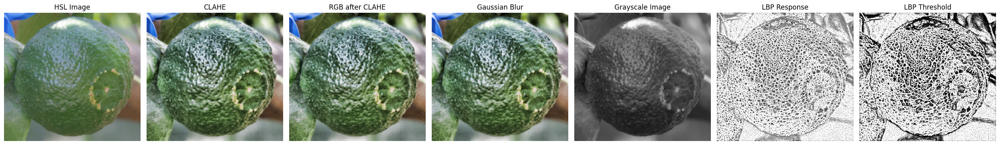

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3150_1.JPG


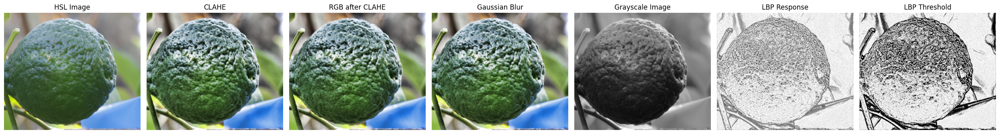

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3151_1.JPG


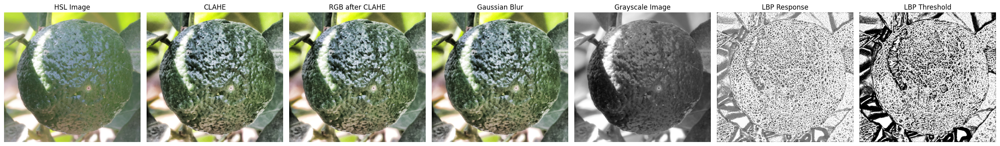

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3152_1.JPG


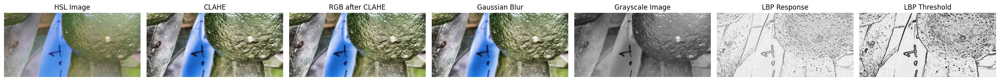

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3152_2.JPG


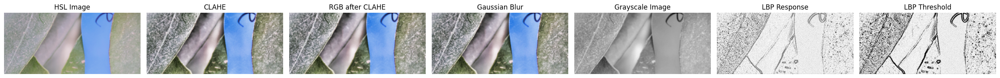

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3153_1.JPG


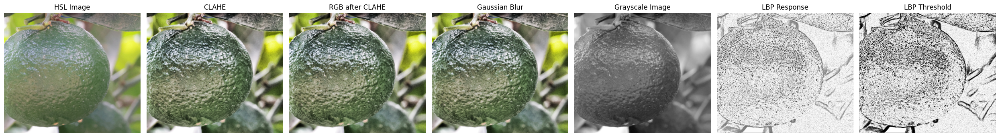

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3154_1.JPG


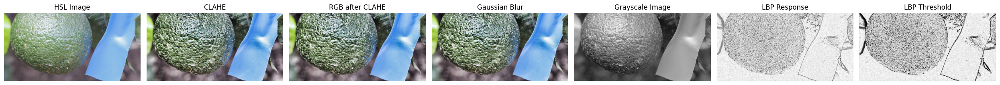

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3155_1.JPG


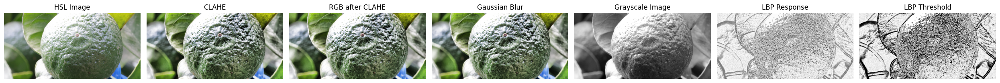

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3156_1.JPG


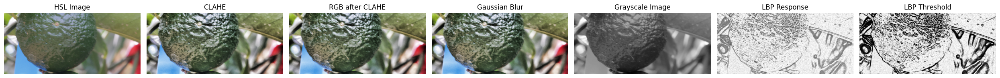

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3157_1.JPG


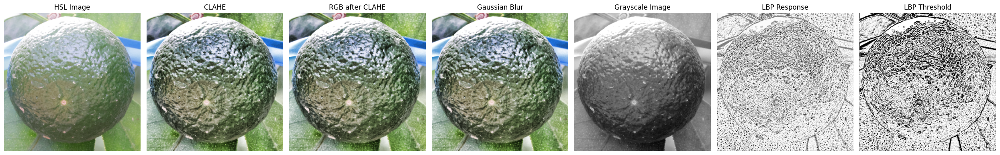

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3158_1.JPG


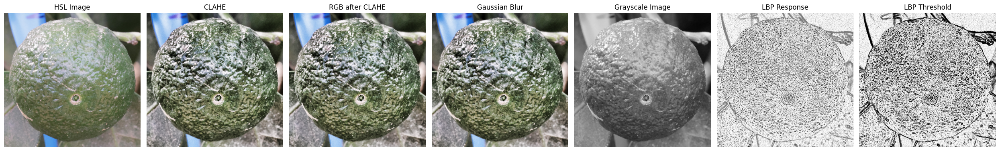

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3159_1.JPG


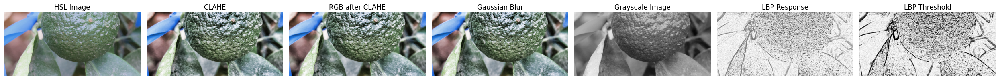

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3160_1.JPG


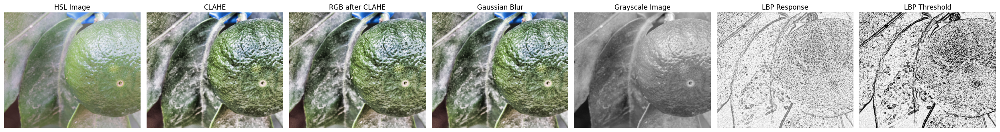

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3161_1.JPG


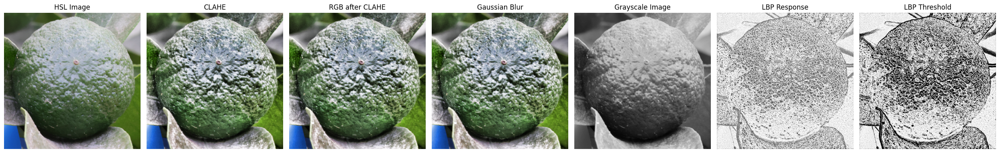

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3162_1.JPG


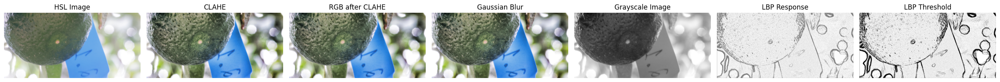

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3163_1.JPG


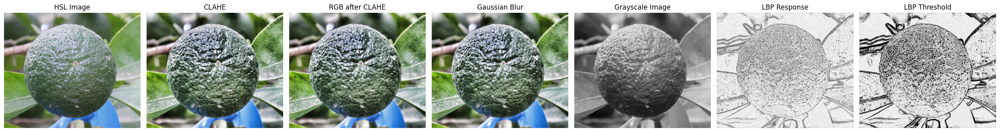

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3167_1.JPG


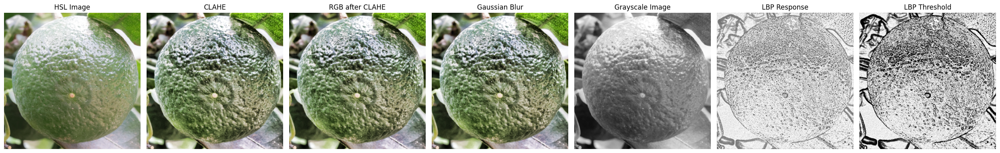

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3168_1.JPG


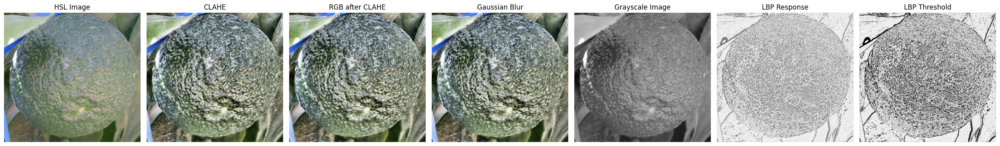

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3169_1.JPG


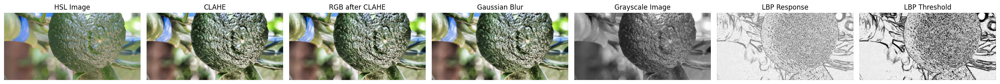

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3170_1.JPG


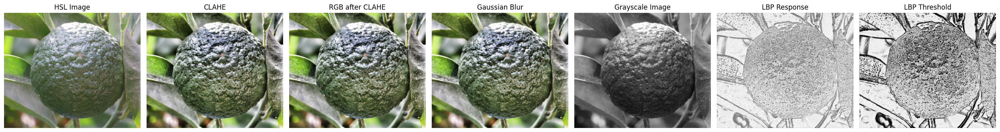

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3172_1.JPG


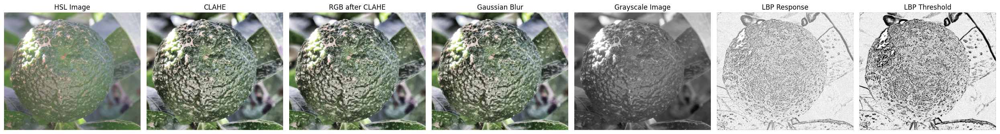

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3173_1.JPG


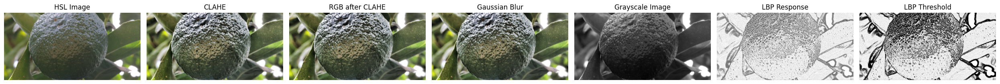

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3174_1.JPG


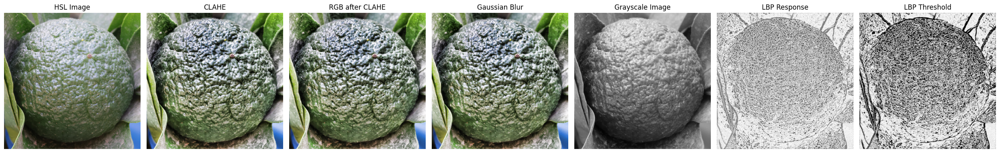

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3175_1.JPG


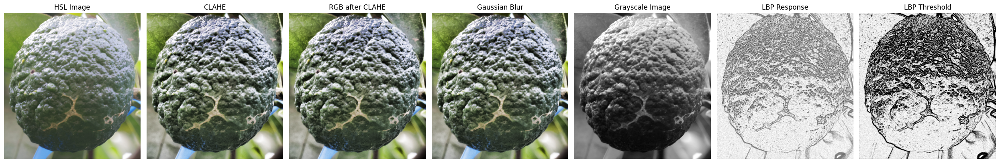

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3176_1.JPG


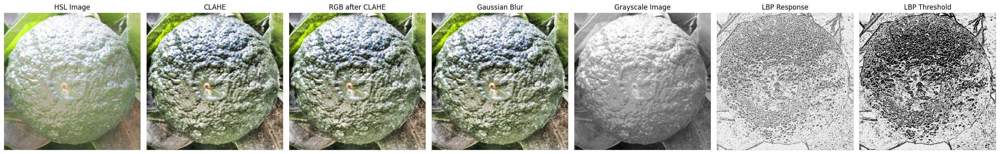

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3176_2.JPG


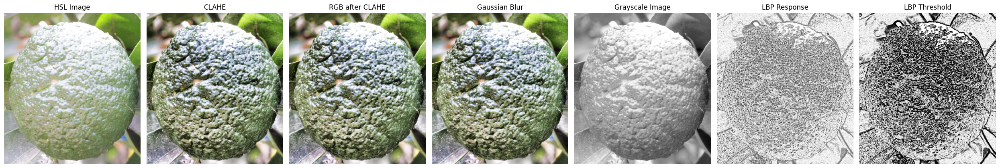

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3177_1.JPG


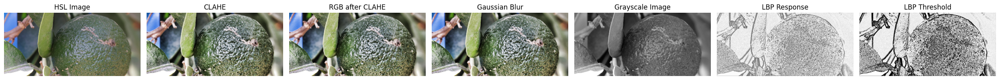

LBP threshold image saved to .\roboflowV6_1169\improved_lbp_30.7\LBP_Thresh_1D3A3178_1.JPG


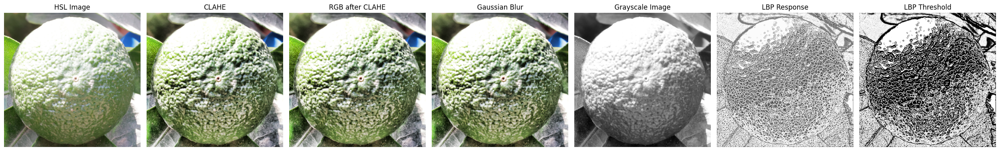

KeyboardInterrupt: 

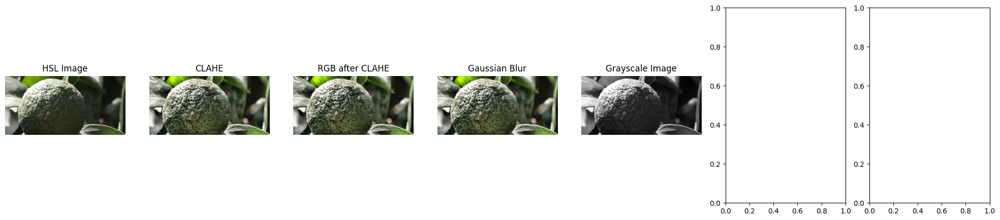

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
import os

def preprocessing_before_threshold_segmentation(image, output_folder, image_name, radius=8, n_points=None, lbp_method='uniform'):
    fig, axes = plt.subplots(1, 7, figsize=(25, 5))
    axes = axes.ravel()

    # Convert from RGB to HSL
    hsl_image = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)
    hsl_image_display = cv2.cvtColor(hsl_image, cv2.COLOR_HLS2RGB)
    axes[0].imshow(hsl_image_display)
    axes[0].set_title('HSL Image')
    axes[0].axis('off')

    # Split into separate channels
    h, l, s = cv2.split(hsl_image)

    # Apply CLAHE to lightness channel
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))  # Adjusted clipLimit
    l_clahe = clahe.apply(l)
    hsl_clahe = cv2.merge((h, l_clahe, s))
    hsl_clahe_display = cv2.cvtColor(hsl_clahe, cv2.COLOR_HLS2RGB)
    axes[1].imshow(hsl_clahe_display)
    axes[1].set_title('CLAHE')
    axes[1].axis('off')

    # Convert back to RGB
    rgb_clahe = cv2.cvtColor(hsl_clahe, cv2.COLOR_HLS2BGR)
    axes[2].imshow(cv2.cvtColor(rgb_clahe, cv2.COLOR_BGR2RGB))
    axes[2].set_title('RGB after CLAHE')
    axes[2].axis('off')

    # Apply Gaussian blur to reduce noise
    blurred_image = cv2.GaussianBlur(rgb_clahe, (5, 5), 0)
    axes[3].imshow(cv2.cvtColor(blurred_image, cv2.COLOR_BGR2RGB))
    axes[3].set_title('Gaussian Blur')
    axes[3].axis('off')

    # Convert the image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    axes[4].imshow(gray_image, cmap='gray')
    axes[4].set_title('Grayscale Image')
    axes[4].axis('off')

    # Apply Local Binary Pattern (LBP)
    if n_points is None:
        n_points = 8 * radius
    lbp = local_binary_pattern(gray_image, n_points, radius, method=lbp_method)
    lbp_normalized = cv2.normalize(lbp, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    axes[5].imshow(lbp_normalized, cmap='gray')
    axes[5].set_title('LBP Response')
    axes[5].axis('off')

    # Apply binary threshold to LBP response
    _, lbp_thresh = cv2.threshold(lbp_normalized, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    axes[6].imshow(lbp_thresh, cmap='gray')
    axes[6].set_title('LBP Threshold')
    axes[6].axis('off')

    # Save LBP threshold image
    lbp_thresh_output_path = os.path.join(output_folder, f"LBP_Thresh_{image_name}")
    cv2.imwrite(lbp_thresh_output_path, lbp_thresh)
    print(f'LBP threshold image saved to {lbp_thresh_output_path}')

    # Show the plot with all images
    plt.tight_layout()
    plt.show()

    return lbp_thresh

def itiration_images_lbp(images_folder, output_directory, radius=8, lbp_method='uniform'):
    # Create output folder if it doesn't exist
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)
    # List all image files
    image_files = os.listdir(images_folder)
    for image_file in image_files:
        if image_file.endswith('.JPG'):  # Assuming images are JPEG format
            # Get image path
            image_path = os.path.join(images_folder, image_file)
            lbp_thresh_output_path = os.path.join(output_directory, f"LBP_Thresh_{image_file}")
            # Check if the LBP threshold image already exists
            if not os.path.exists(lbp_thresh_output_path):
                # Preprocess the image
                image = cv2.imread(image_path)
                lbp_thresh = preprocessing_before_threshold_segmentation(image, output_directory, image_file, radius=radius, lbp_method=lbp_method)
            else:
                print(f'Skipping {image_file} as LBP threshold image already exists.')

    return

# Define input and output folders
images_folder = r'.\roboflowV6_1169\original\bounded'
output_folder = r'.\roboflowV6_1169\again_check_segmented'

# Perform segmentation with LBP
itiration_images_lbp(images_folder, output_folder)


get the circle size from one image 

Image dimensions: Width = 3443 pixels, Height = 3205 pixels


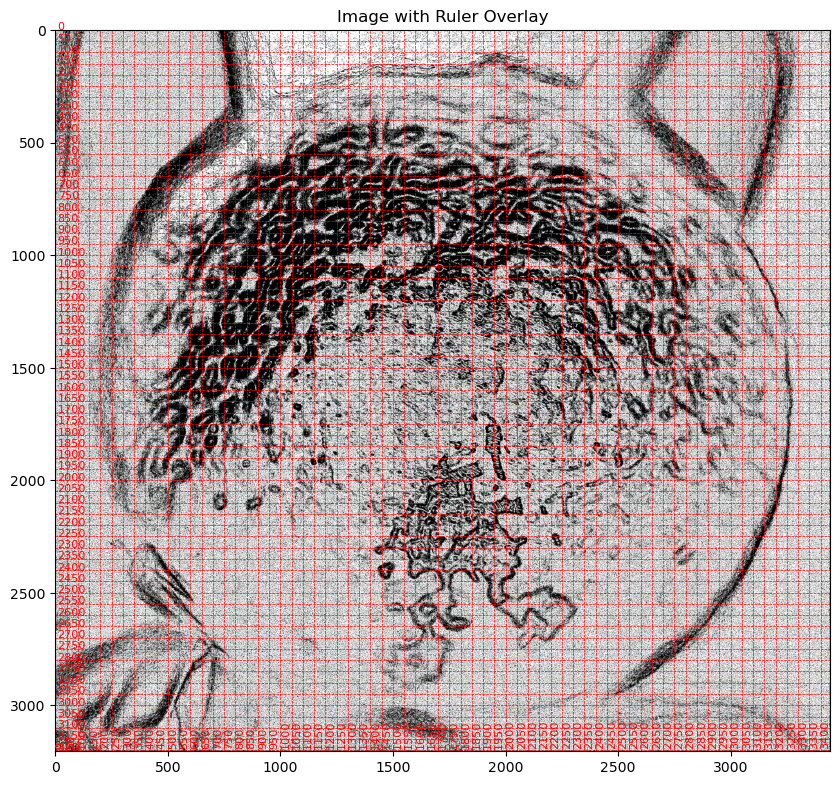

In [5]:
import cv2
import matplotlib.pyplot as plt

# Load image
image_path = './roboflowV6_1169/small_dataset_segmentation/images/segmented_with_lbp_mandarins/LBP_Thresh_1D3A3474_1.JPG'
image = cv2.imread(image_path)

# Check if the image is loaded
if image is not None:
    # Get image dimensions
    height, width, _ = image.shape
    print(f"Image dimensions: Width = {width} pixels, Height = {height} pixels")
    
    # Display image with a ruler overlay
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Image with Ruler Overlay')
    
    # Draw horizontal and vertical rulers
    for i in range(0, width, 50):
        plt.axvline(x=i, color='red', linestyle='--', linewidth=0.5)
        plt.text(i, height - 20, str(i), color='red', fontsize=8, rotation=90)
    for j in range(0, height, 50):
        plt.axhline(y=j, color='red', linestyle='--', linewidth=0.5)
        plt.text(10, j, str(j), color='red', fontsize=8)
    
    plt.show()
else:
    print(f"Error loading image {image_path}")
